      LEVEL 1:   TASK 1:-            Data Exploration and Preprocessing

      

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
data = pd.read_csv(r"C:\Users\hp\Desktop\Cognifyz Data Science Internship\Dataset .csv")

In [23]:
data.head()

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229


                                                 Identify the number of rows and columns.

                                                 

In [24]:
data.shape[0] #Number of rows

9551

In [25]:
data.shape[1] #Number of columns

21

                                                Check for missing values in each column

In [26]:
data.isnull().sum()

Restaurant ID           0
Restaurant Name         0
Country Code            0
City                    0
Address                 0
Locality                0
Locality Verbose        0
Longitude               0
Latitude                0
Cuisines                9
Average Cost for two    0
Currency                0
Has Table booking       0
Has Online delivery     0
Is delivering now       0
Switch to order menu    0
Price range             0
Aggregate rating        0
Rating color            0
Rating text             0
Votes                   0
dtype: int64

In [27]:
print("Total number of missing values across all columns are:", data.isnull().sum().sum())

Total number of missing values across all columns are: 9


In [28]:
for column in data.columns[data.isnull().any()]:
    print(f"Column: '[{column}]' has {data[column].isnull().sum()} missing values")

Column: '[Cuisines]' has 9 missing values


                                                        Handling Missing Values

                        

In [30]:
#Missing value filled by mode
data['Cuisines'].fillna(data['Cuisines'].mode()[0], inplace=True)

In [31]:
#verify if the missing values have been handled
data['Cuisines'].isnull().sum()

np.int64(0)

In [32]:
#identify duplicate rows
data.duplicated().sum()

np.int64(0)

                                            Checked Data type Conversion if necessary

                                            

In [33]:
data.dtypes

Restaurant ID             int64
Restaurant Name          object
Country Code              int64
City                     object
Address                  object
Locality                 object
Locality Verbose         object
Longitude               float64
Latitude                float64
Cuisines                 object
Average Cost for two      int64
Currency                 object
Has Table booking        object
Has Online delivery      object
Is delivering now        object
Switch to order menu     object
Price range               int64
Aggregate rating        float64
Rating color             object
Rating text              object
Votes                     int64
dtype: object

All Data Types in Dataset are already appropriate and there's no need for conversion

                                Analyze the distribution of the target variable ("Aggregate rating")

                                

<Figure size 1500x1000 with 0 Axes>

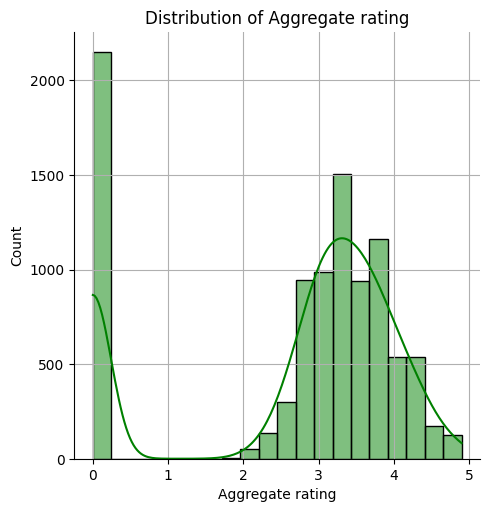

In [34]:
plt.figure(figsize=(15, 10))
sns.displot(data['Aggregate rating'], bins=20, color='Green', kde=True)
plt.title('Distribution of Aggregate rating')
plt.grid(True)
plt.show()

                                                        Identify any class imbalances
                                                        

In [35]:
print("Summary of Aggregate rating:")
data['Aggregate rating'].describe()

Summary of Aggregate rating:


count    9551.000000
mean        2.666370
std         1.516378
min         0.000000
25%         2.500000
50%         3.200000
75%         3.700000
max         4.900000
Name: Aggregate rating, dtype: float64

As the Aggregate rating is (float64) data type. Class imbalance is not applicable for continuous variables like Aggregate rating, so we skip checking the class imbalance.




LEVEL 1:      TASK2:     

                    Calculate basic statistical measures (mean,median, standard deviation, etc.) for numerical columns.




In [36]:
numerical_columns = data.select_dtypes(include=['int64','float64']).columns
numerical_columns

Index(['Restaurant ID', 'Country Code', 'Longitude', 'Latitude',
       'Average Cost for two', 'Price range', 'Aggregate rating', 'Votes'],
      dtype='object')

In [37]:
mean_values = data[numerical_columns].mean()
print("Mean for numerical columns:")
print(mean_values)

Mean for numerical columns:
Restaurant ID           9.051128e+06
Country Code            1.836562e+01
Longitude               6.412657e+01
Latitude                2.585438e+01
Average Cost for two    1.199211e+03
Price range             1.804837e+00
Aggregate rating        2.666370e+00
Votes                   1.569097e+02
dtype: float64


In [38]:
median_values = data[numerical_columns].median()
print("Median for numerical columns:")
print(median_values)

Median for numerical columns:
Restaurant ID           6.004089e+06
Country Code            1.000000e+00
Longitude               7.719196e+01
Latitude                2.857047e+01
Average Cost for two    4.000000e+02
Price range             2.000000e+00
Aggregate rating        3.200000e+00
Votes                   3.100000e+01
dtype: float64


In [39]:
std_values = data[numerical_columns].std()
print("Standard deviation for numerical columns:")
print(std_values)

Standard deviation for numerical columns:
Restaurant ID           8.791521e+06
Country Code            5.675055e+01
Longitude               4.146706e+01
Latitude                1.100794e+01
Average Cost for two    1.612118e+04
Price range             9.056088e-01
Aggregate rating        1.516378e+00
Votes                   4.301691e+02
dtype: float64



                
                Explore the distribution of categorical variables like "Country Code," "City," and"Cuisines."


                

In [40]:
country_code_distribution = data['Country Code'].value_counts()
print("Distribution of Country Code:")
print(country_code_distribution)

Distribution of Country Code:
Country Code
1      8652
216     434
215      80
30       60
189      60
214      60
148      40
208      34
14       24
162      22
94       21
166      20
184      20
191      20
37        4
Name: count, dtype: int64


In [41]:
city_distribution = data['City'].value_counts()
print("Distribution of City:")
print(city_distribution)

Distribution of City:
City
New Delhi         5473
Gurgaon           1118
Noida             1080
Faridabad          251
Ghaziabad           25
                  ... 
Lakes Entrance       1
Mohali               1
Panchkula            1
Bandung              1
Randburg             1
Name: count, Length: 141, dtype: int64


In [42]:
cuisine_distribution = data['Cuisines'].value_counts()
print("Distribution of Cuisine:")
print(cuisine_distribution)

Distribution of Cuisine:
Cuisines
North Indian                          945
North Indian, Chinese                 511
Fast Food                             354
Chinese                               354
North Indian, Mughlai                 334
                                     ... 
World Cuisine, Patisserie, Cafe         1
Burger, Izgara                          1
Desserts, B�_rek                        1
Restaurant Cafe, Turkish, Desserts      1
Restaurant Cafe, Desserts               1
Name: count, Length: 1825, dtype: int64


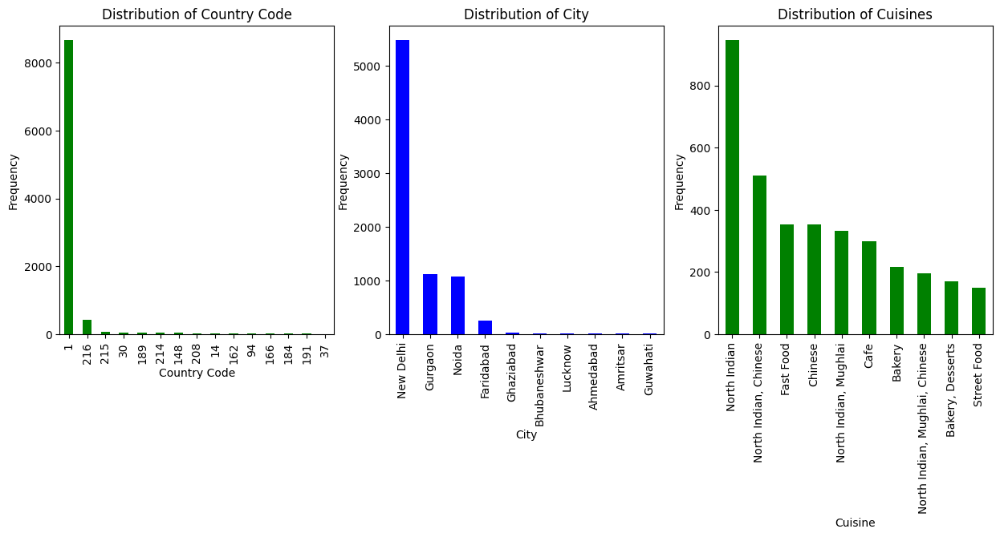

In [43]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
data['Country Code'].value_counts().plot(kind='bar', color='Green')
plt.xlabel('Country Code')
plt.ylabel('Frequency')
plt.title('Distribution of Country Code')

plt.subplot(1, 3, 2)
data['City'].value_counts().head(10).plot(kind='bar', color='Blue')
plt.xlabel('City')
plt.ylabel('Frequency')
plt.title('Distribution of City')

plt.subplot(1, 3, 3)
data['Cuisines'].value_counts().head(10).plot(kind='bar', color='Green')
plt.xlabel('Cuisine')
plt.ylabel('Frequency')
plt.title('Distribution of Cuisines')

plt.show()


                                Identify the top cuisines and cities with the highest number of restaurants.

                                

In [44]:
top_cuisines = data['Cuisines'].value_counts().head(20)
print("Top 20 Cuisines with highest number of restaurants")
print(top_cuisines)

Top 20 Cuisines with highest number of restaurants
Cuisines
North Indian                      945
North Indian, Chinese             511
Fast Food                         354
Chinese                           354
North Indian, Mughlai             334
Cafe                              299
Bakery                            218
North Indian, Mughlai, Chinese    197
Bakery, Desserts                  170
Street Food                       149
Pizza, Fast Food                  131
Chinese, Fast Food                118
Mithai, Street Food               116
South Indian                      112
Bakery, Fast Food                 108
Chinese, North Indian             105
Mughlai                           103
Ice Cream, Desserts                83
Ice Cream                          74
North Indian, Fast Food            74
Name: count, dtype: int64


In [45]:
top_cities = data['City'].value_counts().head(20)
print("Top 20 Cities with highest number of Restaurants")
print(top_cities)

Top 20 Cities with highest number of Restaurants
City
New Delhi          5473
Gurgaon            1118
Noida              1080
Faridabad           251
Ghaziabad            25
Bhubaneshwar         21
Lucknow              21
Ahmedabad            21
Amritsar             21
Guwahati             21
Rio de Janeiro       20
Bras�_lia            20
Albany               20
Doha                 20
Cape Town            20
Manchester           20
London               20
Edinburgh            20
Birmingham           20
Wellington City      20
Name: count, dtype: int64



                                                  LEVEL 1:           TASK 3:

  
                                                     GEOSPATIAL ANALYSIS 
                        Visualize the locations of restaurants on a map using latitude and longitude information

  

In [46]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [47]:
data.columns

Index(['Restaurant ID', 'Restaurant Name', 'Country Code', 'City', 'Address',
       'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines',
       'Average Cost for two', 'Currency', 'Has Table booking',
       'Has Online delivery', 'Is delivering now', 'Switch to order menu',
       'Price range', 'Aggregate rating', 'Rating color', 'Rating text',
       'Votes'],
      dtype='object')

In [48]:
fig = px.scatter_map(data, lat='Latitude', lon='Longitude', hover_name='Restaurant Name', zoom=10, height=600)
fig.update_layout(mapbox_style='open-street-map')
fig.show()

                         Analyze the distribution of restaurants across different cities or countries

                         

In [49]:
data['City'].count()

np.int64(9551)

In [50]:
city_distribution = data['City'].value_counts().head(20).reset_index()
city_distribution.columns = ['City', 'Number of Restaurants']
fig = px.bar(city_distribution, x='City', y='Number of Restaurants', title='Distribution of Restaurants Across the City')
fig.show()

In [30]:
city_distribution = data['City'].value_counts().head(10).reset_index()
city_distribution.columns = ['City', 'Number of Restaurants']
# lets create a pie chart here for visualiztion
fig = px.pie(city_distribution, values='Number of Restaurants', names='City',
             title='Distribution of Restaurants Across Top 10 Cities')
fig.show()

                Determine if there is any corelation between the restaurant's location and its rating.

                

In [31]:
correlation_matrix = data[['Latitude', 'Longitude', 'Aggregate rating']].corr()
correlation_matrix

,Latitude,Longitude,Aggregate rating
Latitude,1.000000,0.043207,0.000516
Longitude,0.043207,1.000000,-0.116818
Aggregate rating,0.000516,-0.116818,1.000000


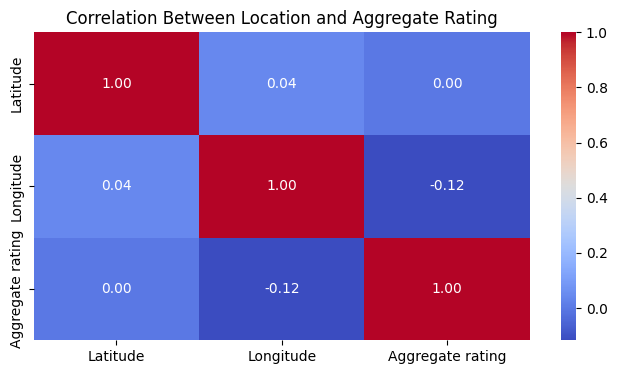

In [32]:
plt.figure(figsize=(8, 4))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Between Location and Aggregate Rating')
plt.show()

                                                                    LEVEL 2    TASK 1: 
                                Determine the percentage of restaurants that offer table booking and online delivery.

                                

In [33]:
data['Has Table booking'] = data['Has Table booking'].map({'Yes':1, 'No':0})
data['Has Online delivery'] = data['Has Online delivery'].map({'Yes':1, 'No':0})

In [34]:
total_restaurants = data.shape[0]
total_restaurants

9551

In [35]:
table_booking_count = data['Has Table booking'].sum()
online_delivery_count = data['Has Online delivery'].sum()
table_booking_count, online_delivery_count

(np.int64(1158), np.int64(2451))

In [36]:
percentage_table_booking = (table_booking_count/ total_restaurants)* 100
percentage_online_delivery = (online_delivery_count/ total_restaurants)* 100
print(f"Percentage of restaurants offering table booking: {percentage_table_booking:.2f}%")
print(f"Percentage of restaurants offering online delivery: {percentage_online_delivery:.2f}%")

Percentage of restaurants offering table booking: 12.12%
Percentage of restaurants offering online delivery: 25.66%


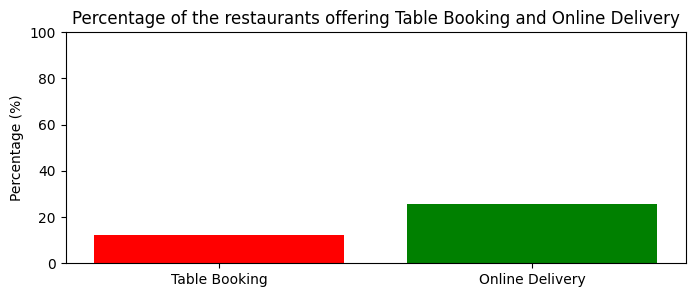

In [37]:
labels = ['Table Booking', 'Online Delivery']
percentage = [percentage_table_booking, percentage_online_delivery]

plt.figure(figsize=(8, 3))
plt.bar(labels, percentage, color=['red', 'green'])
plt.ylabel('Percentage (%)')
plt.title('Percentage of the restaurants offering Table Booking and Online Delivery')
plt.ylim(0, 100)
plt.show()

                             Compare the average ratings of restaurants with table booking and those without.

                     

In [38]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [39]:
data = pd.read_csv(r"C:\Users\hp\Desktop\Cognifyz Data Science Internship\Dataset .csv")

In [40]:
Average_rating_with_booking = data[data['Has Table booking'] == 'Yes']['Aggregate rating'].mean()
Average_rating_without_booking = data[data['Has Table booking'] == 'No']['Aggregate rating'].mean()
print("Average rating for restaurants with table booking:", Average_rating_with_booking)
print("Average rating for restaurants without table booking:", Average_rating_without_booking)

Average rating for restaurants with table booking: 3.4419689119170984
Average rating for restaurants without table booking: 2.559358989634219



                        Analyze the availability of online delivery among restaurants with different price ranges.

                        

In [41]:
data['Has Online delivery'] = data['Has Online delivery'].map({'Yes': 1, 'No': 0})

In [42]:
total_restaurants_per_price_range = data.groupby('Price range')['Restaurant ID'].count()
print("Total restaurants per",total_restaurants_per_price_range)

Total restaurants per Price range
1    4444
2    3113
3    1408
4     586
Name: Restaurant ID, dtype: int64


In [43]:
online_delivery_counts = data.groupby('Price range')['Has Online delivery'].sum()
online_delivery_counts

Price range
1     701
2    1286
3     411
4      53
Name: Has Online delivery, dtype: int64

In [44]:
percentage_delivery = (online_delivery_counts / total_restaurants_per_price_range) * 100
print("Percentage of restaurants offering online delivery by price range:")
print(percentage_delivery)

Percentage of restaurants offering online delivery by price range:
Price range
1    15.774077
2    41.310633
3    29.190341
4     9.044369
dtype: float64


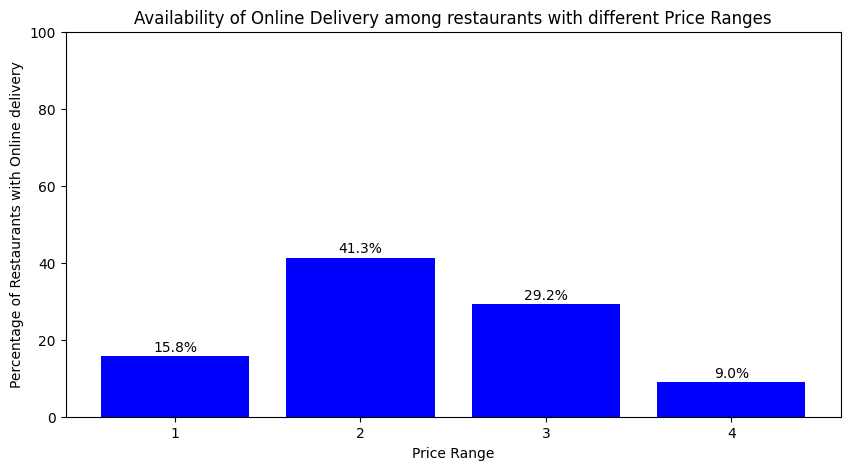

In [45]:
plt.figure(figsize=(10,5))
bars = plt.bar(percentage_delivery.index.astype(str), percentage_delivery.values, color='blue')
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.5, f'{height:.1f}%', ha='center', va='bottom')

plt.xlabel('Price Range')
plt.ylabel('Percentage of Restaurants with Online delivery')
plt.title('Availability of Online Delivery among restaurants with different Price Ranges')
plt.ylim(0,100)
plt.show()

                                                            LEVEL:2 TASK:2 
                                        Determine the most common price range among all the restaurants.

                                        

In [46]:
most_common_price_range = data['Price range'].mode()[0]
print("The most common price range among all the restaurants is:", most_common_price_range)

The most common price range among all the restaurants is: 1



                                                Calculate the average rating for each price range


In [47]:
average_rating_per_price_range = data.groupby('Price range')['Aggregate rating'].mean()
print("Average rating for each price range:", average_rating_per_price_range)

Average rating for each price range: Price range
1    1.999887
2    2.941054
3    3.683381
4    3.817918
Name: Aggregate rating, dtype: float64



                          
                          Identify the color that represents the highest average rating among different price ranges.

                          

In [48]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [49]:
data = pd.read_csv(r"C:\Users\hp\Desktop\Cognifyz Data Science Internship\Dataset .csv")

In [50]:
highest_rating_price_range = average_rating_per_price_range.idxmax()
print("Highest average rating price range:", highest_rating_price_range)

Highest average rating price range: 4


In [51]:
data['Rating color'].value_counts()

Rating color
Orange        3737
White         2148
Yellow        2100
Green         1079
Dark Green     301
Red            186
Name: count, dtype: int64

In [52]:
highest_rating_color = data[data['Price range'] == highest_rating_price_range]['Rating color'].iloc[0]
print("Color Representing the highest average rating among different price ranges is:", highest_rating_color)

Color Representing the highest average rating among different price ranges is: Green



                                                                LEVEL 2 TASK 3: 
                Feature Engineering: Extract additional features from the existing columns, such as the length of the restaurant name or address.

                

In [53]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [54]:
data = pd.read_csv(r"C:\Users\hp\Desktop\Cognifyz Data Science Internship\Dataset .csv")

In [55]:
data.columns

Index(['Restaurant ID', 'Restaurant Name', 'Country Code', 'City', 'Address',
       'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines',
       'Average Cost for two', 'Currency', 'Has Table booking',
       'Has Online delivery', 'Is delivering now', 'Switch to order menu',
       'Price range', 'Aggregate rating', 'Rating color', 'Rating text',
       'Votes'],
      dtype='object')

In [56]:
data['Restaurant Name Length'] = data['Restaurant Name'].apply(len)
data['Address Length'] = data['Address'].apply(len)
data[['Restaurant Name', 'Restaurant Name Length', 'Address', 'Address Length']].head()

,Restaurant Name,Restaurant Name Length,Address,Address Length
0,Le Petit Souffle,16,"Third Floor, Century City Mall, Kalayaan Avenu...",71
1,Izakaya Kikufuji,16,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...",67
2,Heat - Edsa Shangri-La,22,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...",56
3,Ooma,4,"Third Floor, Mega Fashion Hall, SM Megamall, O...",70
4,Sambo Kojin,11,"Third Floor, Mega Atrium, SM Megamall, Ortigas...",64


In [57]:
top_20_restaurants_by_length = data.nlargest(20, 'Restaurant Name Length')[['Restaurant Name', 'Restaurant Name Length']]
top_20_restaurants_by_length

,Restaurant Name,Restaurant Name Length
712,Madhuban Restaurant - Welcome Hotel Rama Inter...,54
2349,Chao Chinese Bistro - Holiday Inn Jaipur City ...,52
2348,Monarch Restaurant - Holiday Inn Jaipur City C...,51
6529,The Great Kabab Factory - Radisson Blu Plaza D...,50
1500,Illusion The Lounge Bar - Hotel Clark Inn Gurgaon,49
2306,Jonathan's Kitchen - Holiday Inn Express & Suites,49
2883,Pt.Kanhaiyalal & Durga Prasad Dixit Paranthe Wale,49
7516,Caf�� Knosh - The Leela Ambience Convention Hotel,49
7517,Cherry Bar - The Leela Ambience Convention Hotel,48
2179,The Living Room - The Westin Sohna Resort & Spa,47


In [58]:
top_20_addresses_by_length = data.nlargest(20, 'Address Length')[['Address', 'Address Length']]
top_20_addresses_by_length

,Address,Address Length
3458,"34, 102B, 109 & 110, Ground/1st Floor, Multile...",132
2307,"Plot 483, 4th Floor, Pemmasani Complex, Bajaj ...",131
8987,"Shop G-2, Ground Floor, Commercial Complex, RG...",128
9417,"Barwa Commercial Avenue, Near Thursday & Frida...",126
9261,"28-10-33/6, Jagdamba Commercial Complex, Chitr...",125
7725,"Shop 4, Plot 11, Behind Sanchit Medicos, Oppos...",123
2545,"2nd Floor, City Centre Mall, Sambaji Chowk, La...",122
2553,"Opposite Asaram Bapu Ashram Bridge, Near Nanda...",122
1745,"165/6, Shining Sun Tower, Furniture Market Nea...",120
4720,"C-7, Tilak Market, Major Pankaj Batra Marg, Bl...",120



                Create new features like "Has Table Booking"or "Has Online Delivery" by encoding categorical variables

                

In [59]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9551 entries, 0 to 9550
Data columns (total 23 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Restaurant ID           9551 non-null   int64  
 1   Restaurant Name         9551 non-null   object 
 2   Country Code            9551 non-null   int64  
 3   City                    9551 non-null   object 
 4   Address                 9551 non-null   object 
 5   Locality                9551 non-null   object 
 6   Locality Verbose        9551 non-null   object 
 7   Longitude               9551 non-null   float64
 8   Latitude                9551 non-null   float64
 9   Cuisines                9542 non-null   object 
 10  Average Cost for two    9551 non-null   int64  
 11  Currency                9551 non-null   object 
 12  Has Table booking       9551 non-null   object 
 13  Has Online delivery     9551 non-null   object 
 14  Is delivering now       9551 non-null   

In [60]:
categorical_columns = data.select_dtypes(include=['object']).columns
categorical_columns

Index(['Restaurant Name', 'City', 'Address', 'Locality', 'Locality Verbose',
       'Cuisines', 'Currency', 'Has Table booking', 'Has Online delivery',
       'Is delivering now', 'Switch to order menu', 'Rating color',
       'Rating text'],
      dtype='object')

In [61]:
import sklearn
from sklearn.preprocessing import LabelEncoder

In [62]:
label_encoder = LabelEncoder()

In [63]:
for col in categorical_columns:
    data[col] = label_encoder.fit_transform(data[col])
data

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes,Restaurant Name Length,Address Length
0,6317637,3748,162,73,8685,171,172,121.027535,14.565443,920,...,0,0,0,3,4.8,0,1,314,16,71
1,6304287,3172,162,73,6055,593,601,121.014101,14.553708,1111,...,0,0,0,3,4.5,0,1,591,16,67
2,6300002,2896,162,75,4684,308,314,121.056831,14.581404,1671,...,0,0,0,4,4.4,1,5,270,22,56
3,6318506,4707,162,75,8690,862,875,121.056475,14.585318,1126,...,0,0,0,4,4.9,0,1,365,4,70
4,6314302,5523,162,75,8689,862,875,121.057508,14.584450,1122,...,0,0,0,4,4.8,0,1,229,11,64
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,5915730,4443,208,140,5926,517,523,28.977392,41.022793,1813,...,0,0,0,3,4.1,1,5,788,11,103
9547,5908749,1310,208,140,5962,552,558,29.041297,41.009847,1824,...,0,0,0,3,4.2,1,5,1034,12,77
9548,5915807,3068,208,140,5966,554,561,29.034640,41.055817,1110,...,0,0,0,4,3.7,5,2,661,5,73
9549,5916112,512,208,140,5967,554,561,29.036019,41.057979,1657,...,0,0,0,4,4.0,1,5,901,11,75


In [64]:
data[['Has Table booking', 'Has Online delivery']].head()

,Has Table booking,Has Online delivery
0,1,0
1,1,0
2,1,0
3,0,0
4,1,0



                                                             LEVEL 3 TASK 2:
                              Analyze the relationship between the type ofcuisine and the restaurant's rating..

                

In [16]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn

In [17]:
data = pd.read_csv(r"C:\Users\hp\Desktop\Cognifyz Data Science Internship\Dataset .csv")

In [18]:
data.isnull().sum().sum()

np.int64(9)

In [20]:
# Missing values filled by mode
data['Cuisines'].fillna(data['Cuisines'].mode()[0], inplace=True)

In [70]:
average_rating_by_cuisine = data.groupby('Cuisines')['Aggregate rating'].mean().sort_values(ascending=False).reset_index()
average_rating_by_cuisine.head(10)

,Cuisines,Aggregate rating
0,"Burger, Bar Food, Steak",4.9
1,"American, Burger, Grill",4.9
2,"American, Caribbean, Seafood",4.9
3,"American, Coffee and Tea",4.9
4,"Mexican, American, Healthy Food",4.9
5,"Italian, Bakery, Continental",4.9
6,"BBQ, Breakfast, Southern",4.9
7,"European, German",4.9
8,"Hawaiian, Seafood",4.9
9,"Sunda, Indonesian",4.9


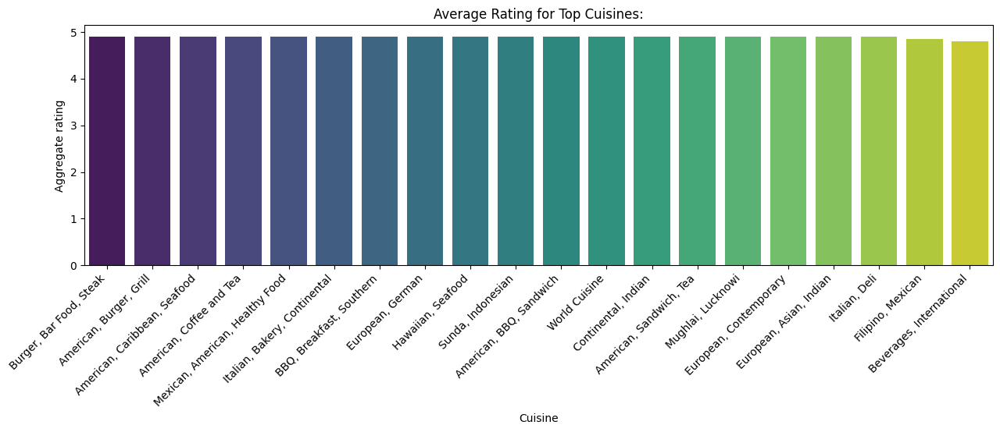

In [71]:
plt.figure(figsize=(15, 4))
sns.barplot(x='Cuisines', y='Aggregate rating', data=average_rating_by_cuisine.head(20), palette='viridis')

plt.title('Average Rating for Top Cuisines:')
plt.xlabel('Cuisine')
plt.ylabel('Aggregate rating')

plt.xticks(rotation=45, ha='right')
plt.show()


                            Identify the most popular cuisines among customers based on the number of votes.

                            

In [73]:
total_votes_per_cuisine = data.groupby('Cuisines')['Votes'].sum().reset_index().sort_values(by='Votes', ascending=False).head(10)
total_votes_per_cuisine

,Cuisines,Votes
1514,"North Indian, Mughlai",53747
1306,North Indian,48967
1329,"North Indian, Chinese",42012
331,Cafe,30657
497,Chinese,21925
1520,"North Indian, Mughlai, Chinese",20115
828,Fast Food,17852
1699,South Indian,16433
1288,"Mughlai, North Indian",15275
1031,Italian,14799


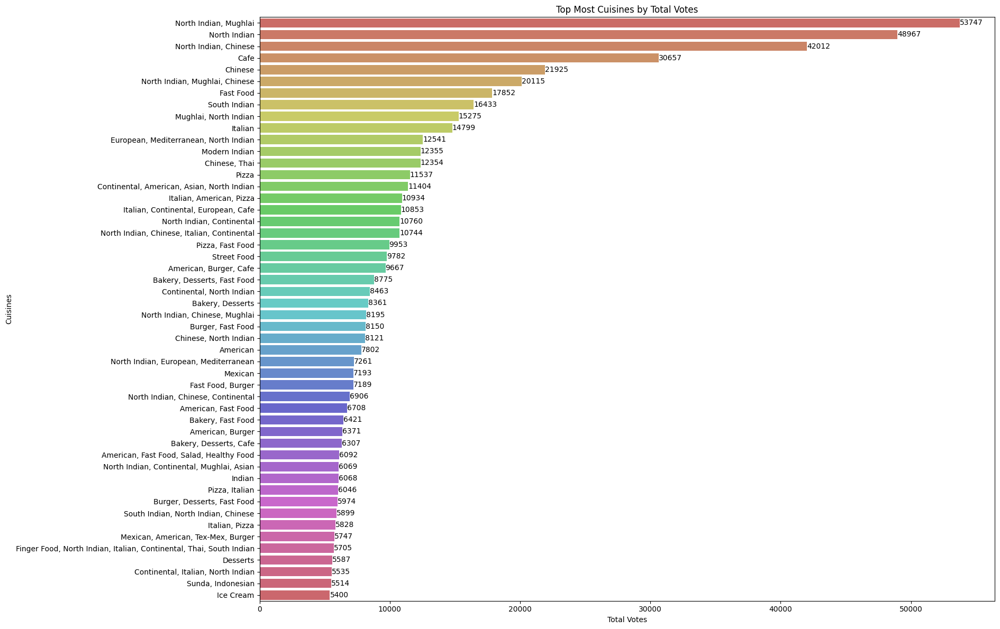

In [74]:
total_votes_per_cuisine = data.groupby('Cuisines')['Votes'].sum().reset_index().sort_values(by='Votes', ascending=False).head(50)

plt.figure(figsize=(19,12))
sns.barplot(x='Votes', y='Cuisines', data=total_votes_per_cuisine, palette='hls')
plt.xlabel('Total Votes')
plt.ylabel('Cuisines')
plt.title('Top Most Cuisines by Total Votes')

for index, value in enumerate(total_votes_per_cuisine['Votes']):
    plt.text(value, index, f'{value}', color='black', ha="left", va='center')

plt.tight_layout()
plt.show()


                          Determine if there are any specific cuisines that tend to receive higher ratings.

                          

In [75]:
average_rating_per_cuisine = data.groupby('Cuisines')['Aggregate rating'].mean().sort_values(ascending=False).head(10)
average_rating_per_cuisine

Cuisines
Burger, Bar Food, Steak            4.9
American, Burger, Grill            4.9
American, Caribbean, Seafood       4.9
American, Coffee and Tea           4.9
Mexican, American, Healthy Food    4.9
Italian, Bakery, Continental       4.9
BBQ, Breakfast, Southern           4.9
European, German                   4.9
Hawaiian, Seafood                  4.9
Sunda, Indonesian                  4.9
Name: Aggregate rating, dtype: float64


LEVEL 3:       TASK 3:                      Data Visualization
        Create visualizations to represent the distribution of ratings using different charts (histogram, barplot, etc.)

        

In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [4]:
data = pd.read_csv(r"C:\Users\hp\Desktop\Cognifyz Data Science Internship\Dataset .csv")

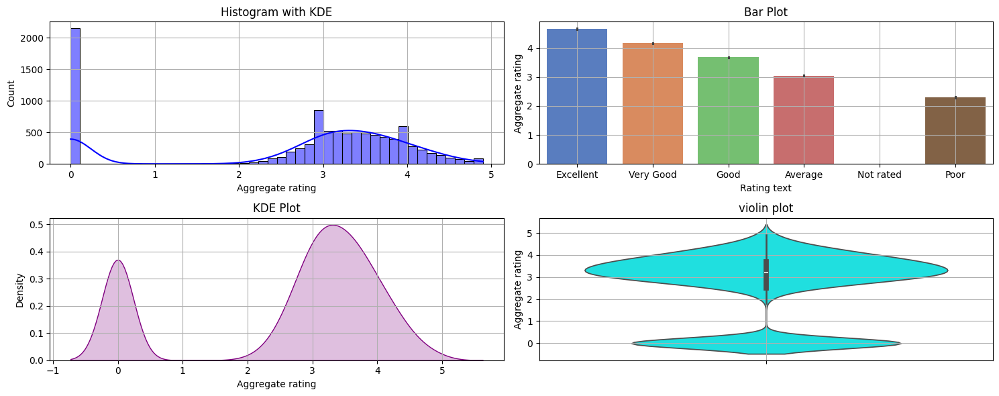

In [79]:
plt.figure(figsize=(15, 6))

#Histogram with KDE Plot
plt.subplot(2, 2, 1)
plt.title('Histogram with KDE')
sns.histplot(data['Aggregate rating'], kde=True, color='blue')
plt.grid(True)

# Bar Plot
plt.subplot(2, 2, 2)
plt.title('Bar Plot')
sns.barplot(x='Rating text', y='Aggregate rating', data=data, palette='muted')
plt.grid(True)

# KDE Plot
plt.subplot(2, 2, 3)
plt.title('KDE Plot')
sns.kdeplot(data=data['Aggregate rating'], color='purple', fill=True)
plt.grid(True)

# Violin Plot
plt.subplot(2, 2, 4)
plt.title('violin plot')
sns.violinplot(data=data, y='Aggregate rating', color='cyan')
plt.grid(True)

plt.tight_layout()
plt.show()



                    Compare the average ratings of different cuisinesor cities using appropriate visualizations

                    

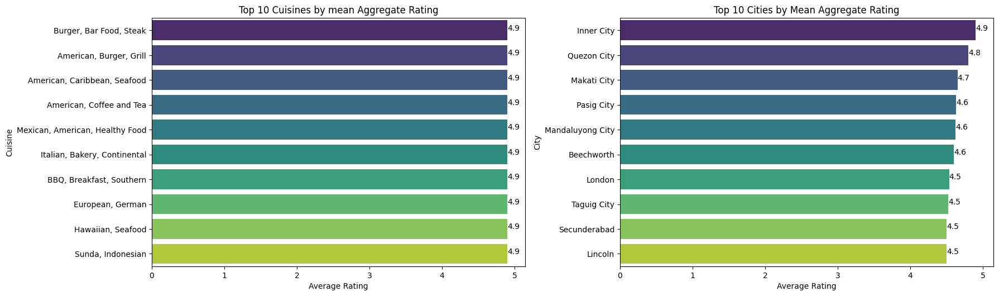

In [82]:
plt.figure(figsize=(18, 10))

plt.subplot(2, 2, 1)
mean_ratings_cuisine = data.groupby('Cuisines')['Aggregate rating'].mean().reset_index().sort_values(by='Aggregate rating', ascending=False).head(10)

sns.barplot(x='Aggregate rating', y='Cuisines', data=mean_ratings_cuisine, palette='viridis')
plt.xlabel('Average Rating')
plt.ylabel('Cuisine')
plt.title('Top 10 Cuisines by mean Aggregate Rating')
for index, value in enumerate(mean_ratings_cuisine['Aggregate rating']):
    plt.text(value, index, f'{value:.1f}', color='black', ha='left')

plt.subplot(2, 2, 2)
mean_ratings_city = data.groupby('City')['Aggregate rating'].mean().reset_index().sort_values(by='Aggregate rating', ascending=False).head(10)

sns.barplot(x='Aggregate rating', y='City', data=mean_ratings_city, palette='viridis')
plt.xlabel('Average Rating')
plt.ylabel('City')
plt.title('Top 10 Cities by Mean Aggregate Rating')
for index, value in enumerate(mean_ratings_city['Aggregate rating']):
    plt.text(value, index, f'{value:.1f}', color='black', ha="left")

plt.tight_layout()
plt.show()


                    
                    Visualize the relationship between various features and the target variable to gain insights.

                    

In [6]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [7]:
data = pd.read_csv(r"C:\Users\hp\Desktop\Cognifyz Data Science Internship\Dataset .csv")

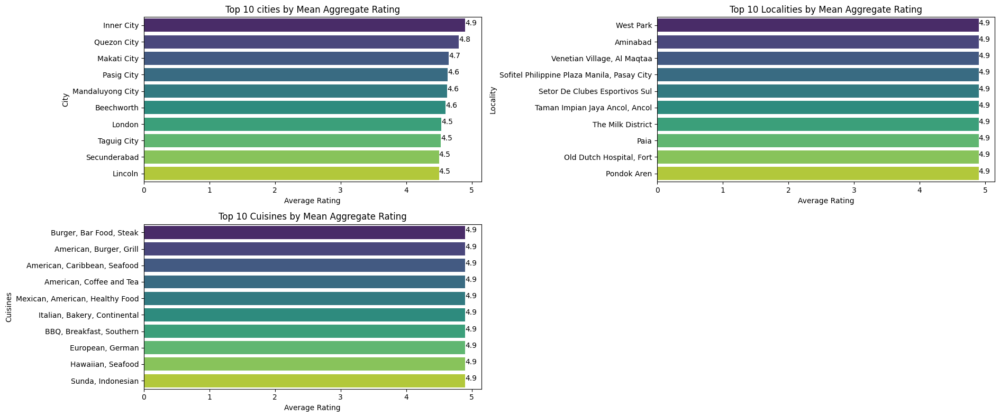

In [25]:
plt.figure(figsize=(19, 8))

#Mean Aggregate Rating by Top 10 Cities
plt.subplot(2, 2, 1)
mean_ratings_city = data.groupby('City')['Aggregate rating'].mean().reset_index().sort_values(by='Aggregate rating', ascending=False).head(10)
sns.barplot(x='Aggregate rating', y='City', data=mean_ratings_city, palette='viridis')
plt.xlabel('Average Rating')
plt.ylabel('City')
plt.title('Top 10 cities by Mean Aggregate Rating')
for index, value in enumerate(mean_ratings_city['Aggregate rating']):
    plt.text(value, index, f'{value:.1f}', color='black', ha="left")

#Mean Aggregate Rating by Top 10 Localities
plt.subplot(2, 2, 2)
mean_ratings_locality = data.groupby('Locality')['Aggregate rating'].mean().reset_index().sort_values(by='Aggregate rating', ascending=False).head(10)                                                                                             
sns.barplot(x='Aggregate rating', y='Locality', data=mean_ratings_locality, palette='viridis')
plt.xlabel('Average Rating')
plt.ylabel('Locality')
plt.title('Top 10 Localities by Mean Aggregate Rating')
for index, value in enumerate(mean_ratings_locality['Aggregate rating']):
    plt.text(value, index, f'{value:.1f}', color='black', ha="left")

# Mean Aggregate Rating by Top 10 Cuisines
plt.subplot(2, 2, 3)
mean_ratings_cuisine = data.groupby('Cuisines')['Aggregate rating'].mean().reset_index().sort_values(by='Aggregate rating', ascending=False).head(10)                                                                                             
sns.barplot(x='Aggregate rating', y='Cuisines', data=mean_ratings_cuisine, palette='viridis')
plt.xlabel('Average Rating')
plt.ylabel('Cuisines')
plt.title('Top 10 Cuisines by Mean Aggregate Rating')
for index, value in enumerate(mean_ratings_cuisine['Aggregate rating']):
    plt.text(value, index, f'{value:.1f}', color='black', ha="left")

plt.tight_layout()
plt.show()


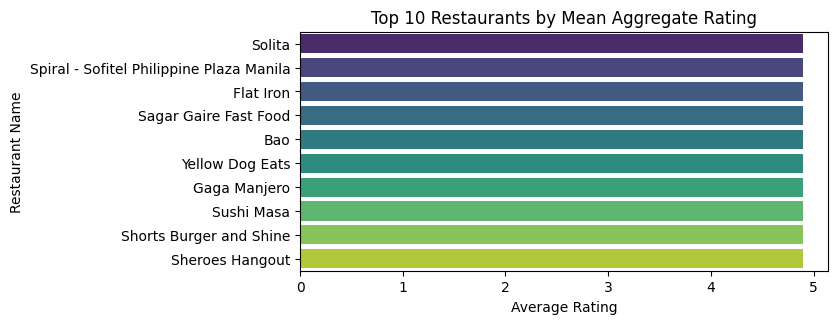

In [26]:
# Top 10 Restaurants by Mean Aggregate Rating
plt.figure(figsize=(15, 18))
plt.subplot(5, 2, 1)
mean_ratings_restaurant = data.groupby('Restaurant Name')['Aggregate rating'].mean().reset_index().sort_values(by='Aggregate rating', ascending=False).head(10)                                                                                             
sns.barplot(x='Aggregate rating', y='Restaurant Name', data=mean_ratings_restaurant, palette='viridis')
plt.xlabel('Average Rating')
plt.ylabel('Restaurant Name')
plt.title('Top 10 Restaurants by Mean Aggregate Rating')

plt.show()



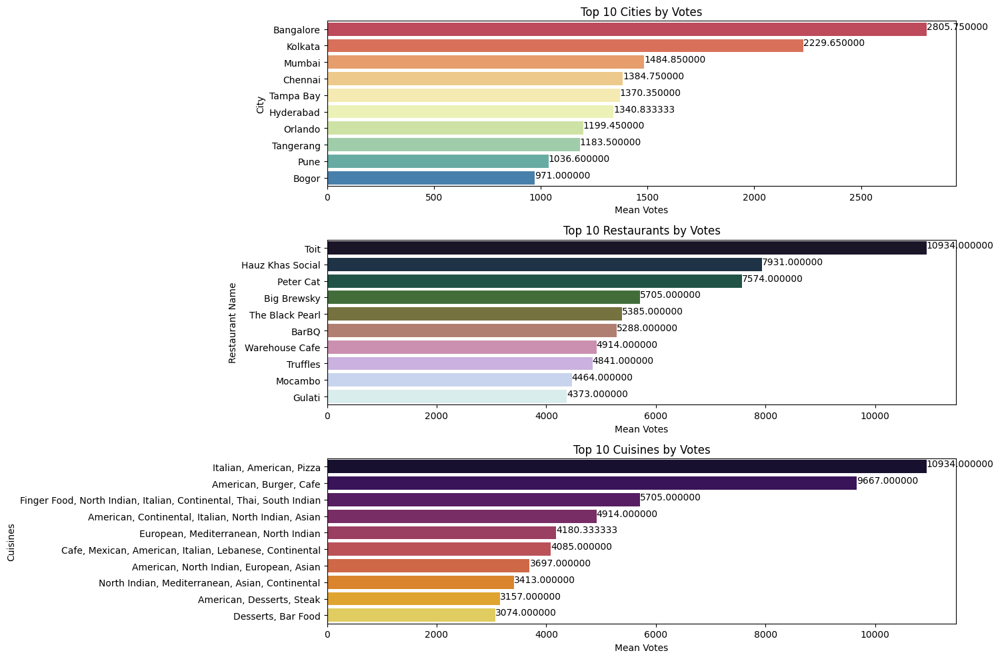

In [55]:
plt.figure(figsize=(15, 10))

# Top 10 Cities by Votes
top_cities = data.groupby('City')['Votes'].mean().reset_index().sort_values(by='Votes', ascending=False).head(10)
plt.subplot(3, 1, 1)
sns.barplot(x='Votes', y='City', data=top_cities, palette='Spectral')
plt.xlabel('Mean Votes')
plt.ylabel('City')
plt.title('Top 10 Cities by Votes')

for index, value in enumerate(top_cities['Votes']):
    plt.text(value, index, f'{value:0f}', color='black', ha="left")

# Top 10 Restaurants by Votes
top_restaurants = data.groupby('Restaurant Name')['Votes'].mean().reset_index().sort_values(by='Votes', ascending=False).head(10)
plt.subplot(3, 1, 2)
sns.barplot(x='Votes', y='Restaurant Name', data=top_restaurants, palette='cubehelix')
plt.xlabel('Mean Votes')
plt.ylabel('Restaurant Name')
plt.title('Top 10 Restaurants by Votes')

for index, value in enumerate(top_restaurants['Votes']):
    plt.text(value, index, f'{value:0f}', color='black', ha="left")

# Top 10 Cuisines by Votes
top_cuisines = data.groupby('Cuisines')['Votes'].mean().reset_index().sort_values(by='Votes', ascending=False).head(10)
plt.subplot(3, 1, 3)
sns.barplot(x='Votes', y='Cuisines', data=top_cuisines, palette='inferno',color='Magenta')
plt.xlabel('Mean Votes')
plt.ylabel('Cuisines')
plt.title('Top 10 Cuisines by Votes')

for index, value in enumerate(top_cuisines['Votes']):
    plt.text(value, index, f'{value:0f}', color='black', ha="left")

plt.tight_layout()
plt.show()

In [9]:
data.to_csv("Updated Dataset.csv", index=False)


                                                                    
                                                                    
                                                                    ---END--



                                                                    